In [1]:
import pandas as pd
import folium
from folium.plugins import MarkerCluster
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

In [2]:
# 读取 CSV 数据（请根据实际路径替换文件路径）
df = pd.read_csv("Motor_Vehicle_Collisions.csv")

### Initial Data Exploration

We begin by exploring the dataset to understand the general structure and the available attributes. Our goal is to find useful patterns and trends in spatial and temporal accident data within Manhattan.

We will look at basic statistics and distributions for crash date and time, which are important for understanding accident patterns.


In [3]:
# Print basic stats and missing values
print("Total records:", len(df))
print("Missing latitude/longitude:", df["LATITUDE"].isna().sum())
print("Manhattan-only records:", (df["BOROUGH"] == "MANHATTAN").sum())
df["CRASH DATE"] = pd.to_datetime(df["CRASH DATE"], errors="coerce")
print("\nDate Range:", df["CRASH DATE"].min(), "to", df["CRASH DATE"].max())

Total records: 30101
Missing latitude/longitude: 447
Manhattan-only records: 30101

Date Range: 2023-01-02 00:00:00 to 2025-07-06 00:00:00


### Temporal Distribution of Accidents

To understand how accident frequency varies over time, we create a histogram of crash dates. This helps us see trends or seasonality.

This attribute (CRASH DATE) tells us **when** accidents happened but **not** why they occurred or the severity — it is purely temporal.


<Axes: title={'center': 'Monthly Accident Counts (All Boroughs)'}, xlabel='CRASH DATE'>

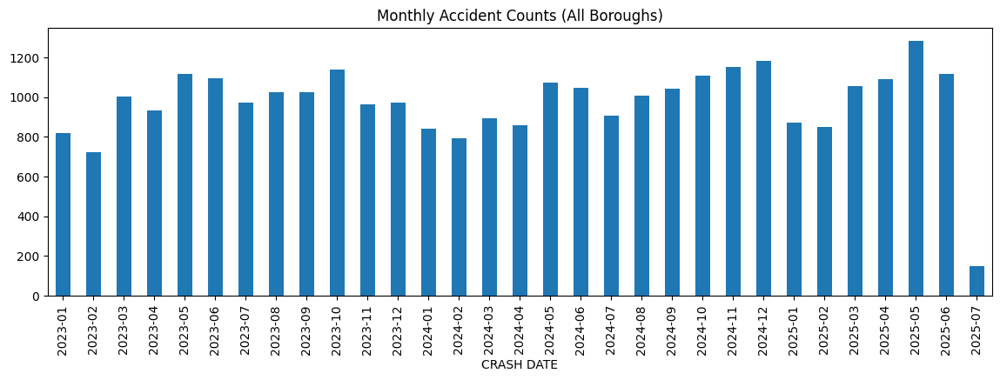

In [4]:
df["CRASH DATE"].dropna().dt.to_period("M").value_counts().sort_index().plot(
    kind="bar", figsize=(14, 4), title="Monthly Accident Counts (All Boroughs)"
)

### Manhattan-Only Accident Dates

Let’s now filter only Manhattan-based accidents and repeat the visualization. This ensures our later map corresponds to a focused spatial area.


<Axes: title={'center': 'Monthly Accident Counts (Manhattan Only)'}, xlabel='CRASH DATE'>

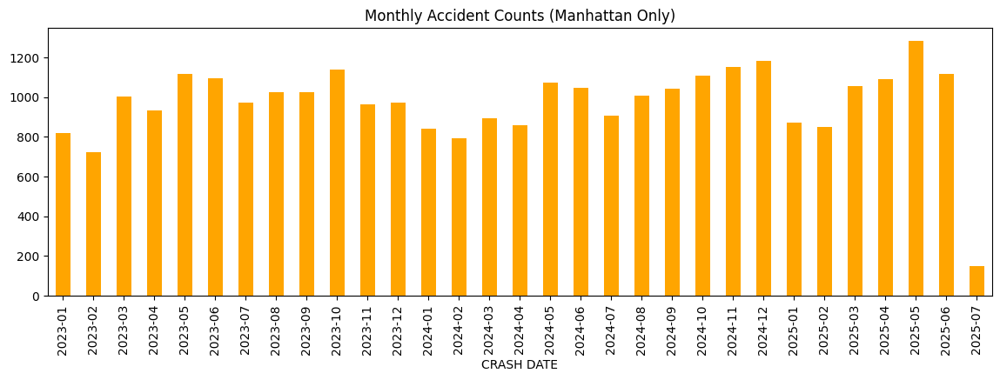

In [5]:
df_m = df[df["BOROUGH"] == "MANHATTAN"].copy()
df_m["CRASH DATE"] = pd.to_datetime(df_m["CRASH DATE"], errors="coerce")
df_m["CRASH DATE"].dropna().dt.to_period("M").value_counts().sort_index().plot(
    kind="bar",
    figsize=(14, 4),
    color="orange",
    title="Monthly Accident Counts (Manhattan Only)",
)

### Visualizing in Space and Time

Now that we understand the time trends, we move to spatial analysis.

We use **color gradients over time** to visualize the evolution of accidents geographically across Manhattan. This representation **shows where and when** accidents occurred but does not show accident type or severity — for that, further layers would be required.


In [6]:
# 仅选择 Manhattan 区域并去除缺失经纬度的数据
df_filtered = df[
    (df["BOROUGH"] == "MANHATTAN") & df["LATITUDE"].notna() & df["LONGITUDE"].notna()
].copy()

# 转换日期格式并按时间排序
df_filtered["CRASH DATE"] = pd.to_datetime(df_filtered["CRASH DATE"], errors="coerce")
df_filtered = df_filtered.sort_values("CRASH DATE")

# 归一化时间用于颜色映射
norm = plt.Normalize(
    df_filtered["CRASH DATE"].min().toordinal(),
    df_filtered["CRASH DATE"].max().toordinal(),
)
colors = plt.cm.viridis(norm(df_filtered["CRASH DATE"].apply(lambda x: x.toordinal())))

In [7]:
# 创建地图
m = folium.Map(location=[40.7831, -73.9712], zoom_start=12, tiles="cartodbpositron")

# 添加事故点（使用颜色表示时间）
for idx, row in df_filtered.iterrows():
    color = mcolors.to_hex(colors[idx % len(colors)])  # 处理颜色索引
    folium.CircleMarker(
        location=(row["LATITUDE"], row["LONGITUDE"]),
        radius=3,
        color=color,
        fill=True,
        fill_opacity=0.6,
        weight=0,
    ).add_to(m)

In [9]:
m

In [ ]:
# 保存为 HTML 文件
m.save("manhattan_accidents_map.html")